In [1]:
import xscen as xs
import xarray as xr
import cartopy.crs as ccrs
from xscen.config import CONFIG
import figanos.matplotlib as fg
import matplotlib.pyplot as plt
fg.utils.set_mpl_style('ouranos')

# Load configuration
xs.load_config(
    "../paths_obs.yml", "../config_obs.yml", verbose=(__name__ == "__main__"), reset=True
)

In [2]:
pcat = xs.ProjectCatalog(CONFIG["paths"]["project_catalog"])
pcat.df

,id,type,processing_level,bias_adjust_institution,bias_adjust_project,mip_era,activity,driving_model,institution,source,...,xrfreq,frequency,variable,domain,date_start,date_end,version,format,path,performance_base
0,ECMWF_ERA5-Land_NAM_reconstruction,reconstruction,extracted,NaN,NaN,NaN,NaN,NaN,ECMWF,ERA5-Land,...,D,day,"(tasmax, tasmin, pr, tas)",Quebec,1980-01-01,2021-12-31,NaN,zarr,/tank/jlavoie/abuyalo/obsflow/extracted/ECMWF_...,NaN
1,GovCan_RDRS_NAM_reconstruction,reconstruction,extracted,NaN,NaN,NaN,NaN,NaN,GovCan,RDRS,...,D,day,"(tasmax, tasmin, pr, tas)",Quebec,1980-01-01,2018-12-31,v21,zarr,/tank/jlavoie/abuyalo/obsflow/extracted/GovCan...,NaN
2,GovCan_CaSR_NAM_reconstruction,reconstruction,extracted,NaN,NaN,NaN,NaN,NaN,GovCan,CaSR,...,D,day,"(tasmax, tasmin, pr, tas)",Quebec,1980-01-01,2023-12-31,v31,zarr,/tank/jlavoie/abuyalo/obsflow/extracted/GovCan...,NaN
3,USask_EMDNA_OI_NAM_reconstruction,reconstruction,extracted,NaN,NaN,NaN,NaN,NaN,USask,EMDNA,...,D,day,"(tasmax, tasmin, pr, tas)",Quebec,1980-01-01,2018-12-31,v10,zarr,/tank/jlavoie/abuyalo/obsflow/extracted/USask_...,NaN
4,PCIC_PCICBlend_CAN_reconstruction,reconstruction,extracted,NaN,NaN,NaN,NaN,NaN,PCIC,PCICBlend,...,D,day,"(tasmax, tasmin, pr, tas)",Quebec,1980-01-01,2012-12-31,v1,zarr,/tank/jlavoie/abuyalo/obsflow/extracted/PCIC_P...,NaN
5,GovCan_AHCCD_CAN_station-tas,station-tas,extracted,NaN,NaN,NaN,NaN,NaN,GovCan,AHCCD,...,D,day,"(tasmax, tasmin, tas)",Quebec,1980-01-01,2023-12-31,gen3,zarr,/tank/jlavoie/abuyalo/obsflow/extracted/GovCan...,NaN
6,GovCan_AHCCD_CAN_station-pr,station-pr,extracted,NaN,NaN,NaN,NaN,NaN,GovCan,AHCCD,...,D,day,"(pr,)",Quebec,1980-01-01,2017-12-31,gen2,zarr,/tank/jlavoie/abuyalo/obsflow/extracted/GovCan...,NaN
7,ECMWF_ERA5-Land_NAM_reconstruction,reconstruction,indicators,NaN,NaN,NaN,NaN,NaN,ECMWF,ERA5-Land,...,YS-JAN,yr,"(pr_mean_annual, tg_mean_annual)",Quebec,1980-01-01,2021-01-01,NaN,zarr,/tank/jlavoie/abuyalo/obsflow/indicators/ECMWF...,NaN
8,ECMWF_ERA5-Land_NAM_reconstruction,reconstruction,indicators,NaN,NaN,NaN,NaN,NaN,ECMWF,ERA5-Land,...,QS-DEC,qtr,"(pr_mean_seasonal, tg_mean_seasonal)",Quebec,1980-03-01,2021-12-01,NaN,zarr,/tank/jlavoie/abuyalo/obsflow/indicators/ECMWF...,NaN
9,GovCan_AHCCD_CAN_station-pr,station-pr,indicators,NaN,NaN,NaN,NaN,NaN,GovCan,AHCCD,...,YS-JAN,yr,"(pr_mean_annual,)",Quebec,1980-01-01,2017-01-01,gen2,zarr,/tank/jlavoie/abuyalo/obsflow/indicators/GovCa...,NaN


In [3]:
def plot(processing_level):    
    dict_ext = pcat.search(processing_level=processing_level).to_dataset_dict()  # Get all datasets with the given processing level
    
    for id, ds in dict_ext.items():  # For each dataset
        if ds.attrs['cat:type'] == 'reconstruction':
            plotting_function = fg.gridmap
        else:
            plotting_function = fg.scattermap
            
        for var in ds.data_vars:  # For each variable
            var_ds = ds[var]  # Dataset for the current variable
            coords = var_ds.coords

            if 'lat' in coords and 'lon' in coords:  # If the variable can be plotted on a 2D lat/lon plot

                horizons = [None]
                if 'horizon' in coords:
                    horizons = var_ds.horizon.values  # Loop over all horizons
                
                for horizon_val in horizons:
                    sub_ds = var_ds
                    if horizon_val is not None:
                        sub_ds = var_ds.sel(horizon=horizon_val)

                    if 'time' in sub_ds.coords:
                        ith_time = int(len(sub_ds.time) / 2)
                        sub_ds = sub_ds.isel(time=ith_time)
                        show_time = True
                    else:
                        show_time = False

                    title_suffix = f"\nHorizon: {horizon_val}" if horizon_val is not None else ""

                    if 'season' in sub_ds.coords:
                        ax = plotting_function(
                            sub_ds,
                            projection=ccrs.LambertConformal(),
                            fig_kw={"figsize": (20, 5)},
                            plot_kw={"col": "season"},
                            features=["coastline"],
                            show_time=show_time,
                            frame=False,
                            enumerate_subplots=True
                        )
                        ax.fig.suptitle(id, fontsize=16, y=1.03)
                    else:
                        ax = plotting_function(sub_ds, show_time=show_time, features=['coastline'])
                        ax.set_title(f"{id}{title_suffix}", fontsize=14)



--> The keys in the returned dictionary of datasets are constructed as follows:
	'id.domain.processing_level.xrfreq'


/exec/abuyalo/.conda/envs/obsflow/lib/python3.12/site-packages/figanos/matplotlib/utils.py:227: UserWarning: Attribute "description" not found.
/exec/abuyalo/.conda/envs/obsflow/lib/python3.12/site-packages/figanos/matplotlib/utils.py:227: UserWarning: Attribute "description" not found.
/exec/abuyalo/.conda/envs/obsflow/lib/python3.12/site-packages/figanos/matplotlib/utils.py:227: UserWarning: Attribute "description" not found.
/exec/abuyalo/.conda/envs/obsflow/lib/python3.12/site-packages/figanos/matplotlib/utils.py:227: UserWarning: Attribute "description" not found.
/exec/abuyalo/.conda/envs/obsflow/lib/python3.12/site-packages/figanos/matplotlib/utils.py:227: UserWarning: Attribute "description" not found.
/exec/abuyalo/.conda/envs/obsflow/lib/python3.12/site-packages/figanos/matplotlib/utils.py:227: UserWarning: Attribute "description" not found.
/exec/abuyalo/.conda/envs/obsflow/lib/python3.12/site-packages/figanos/matplotlib/utils.py:227: UserWarning: Attribute "description" not

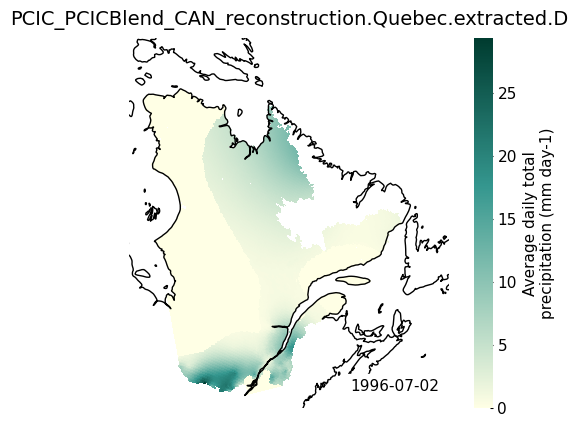

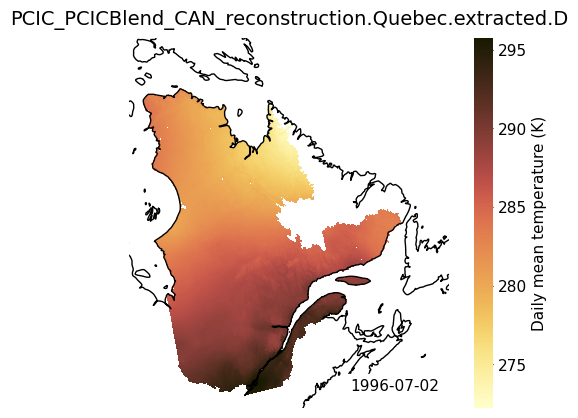

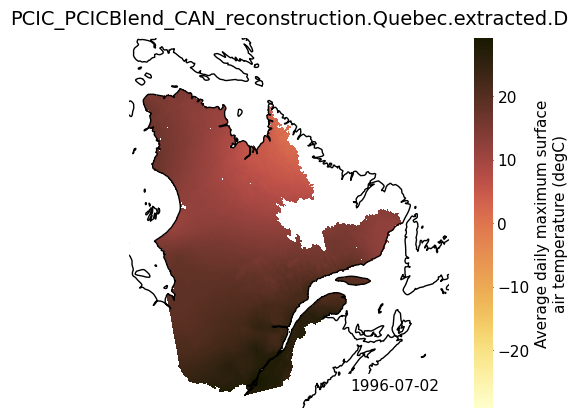

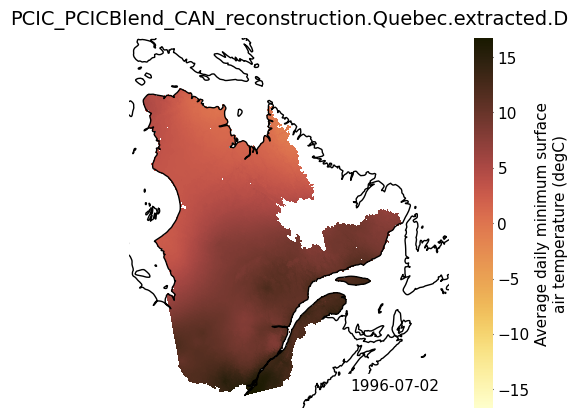

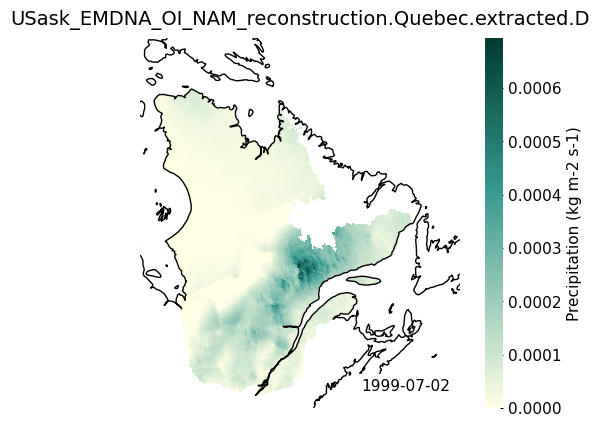

...

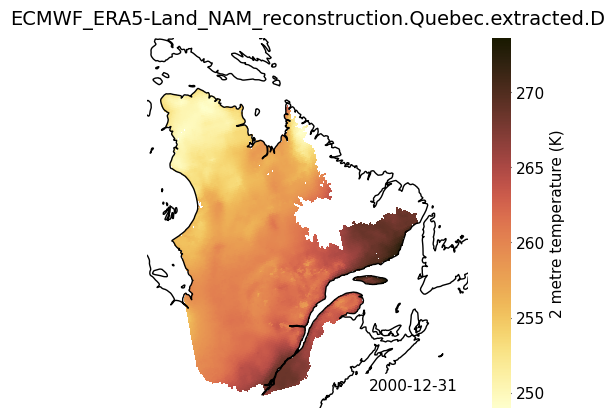

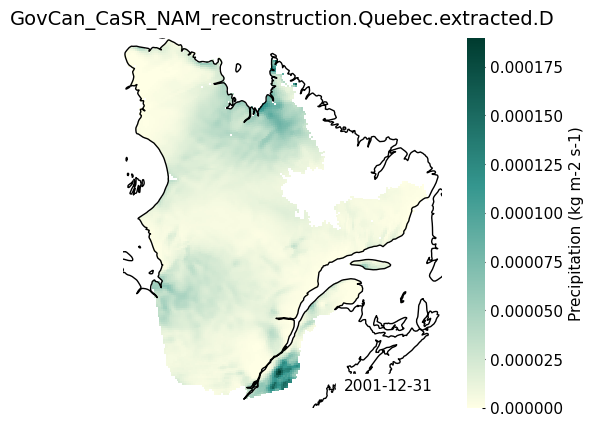

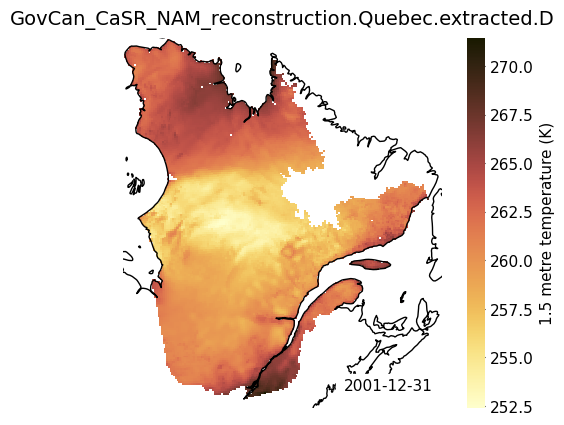

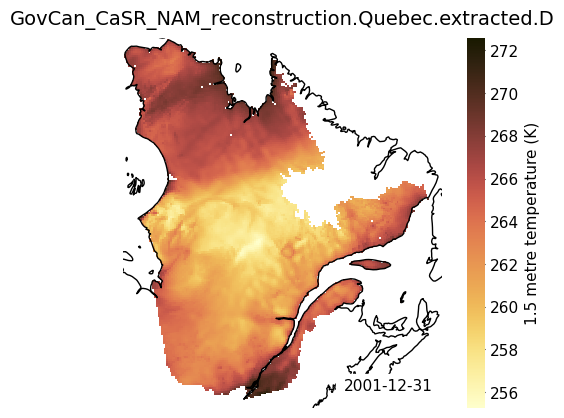

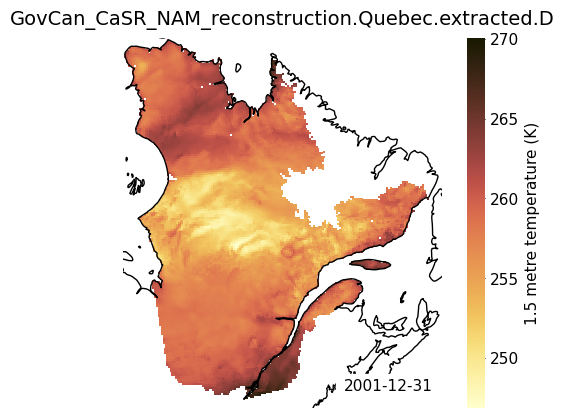

In [12]:
plot(processing_level='extracted')


--> The keys in the returned dictionary of datasets are constructed as follows:
	'id.domain.processing_level.xrfreq'


/exec/abuyalo/.conda/envs/obsflow/lib/python3.12/site-packages/figanos/matplotlib/plot.py:1748: UserWarning: 20 nan values were dropped when plotting the color values
/exec/abuyalo/.conda/envs/obsflow/lib/python3.12/site-packages/figanos/matplotlib/plot.py:1748: UserWarning: 31 nan values were dropped when plotting the color values
/exec/abuyalo/.conda/envs/obsflow/lib/python3.12/site-packages/figanos/matplotlib/plot.py:1748: UserWarning: 37 nan values were dropped when plotting the color values
/exec/abuyalo/.conda/envs/obsflow/lib/python3.12/site-packages/figanos/matplotlib/plot.py:1748: UserWarning: 46 nan values were dropped when plotting the color values


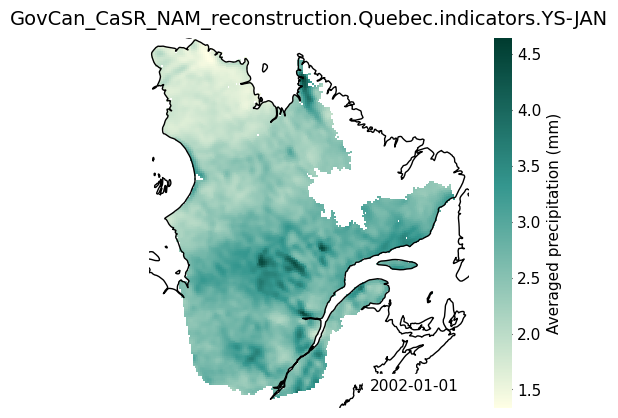

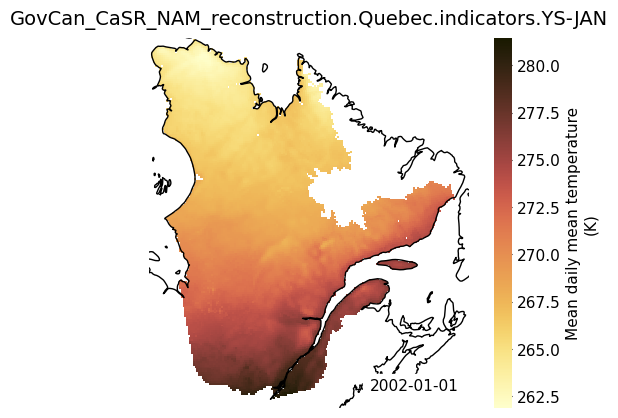

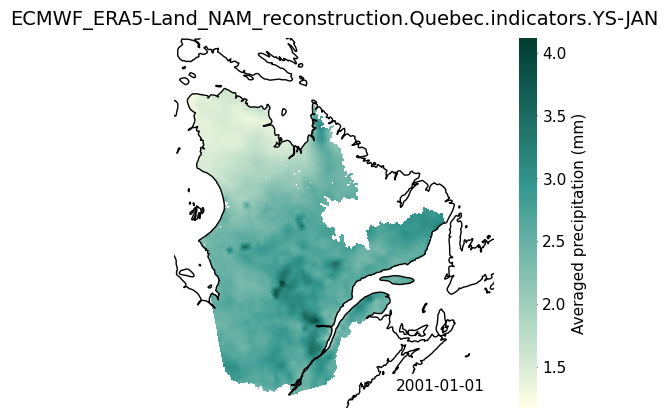

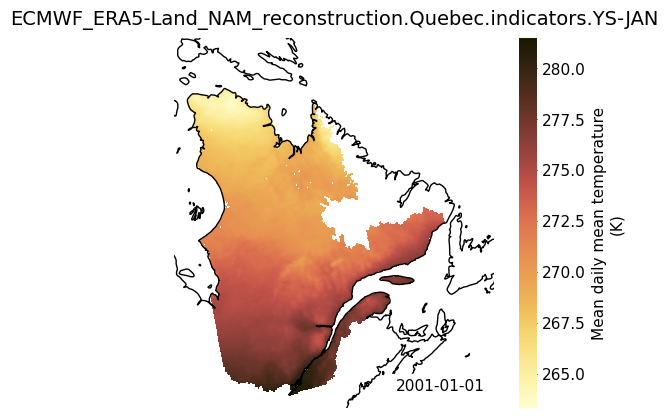

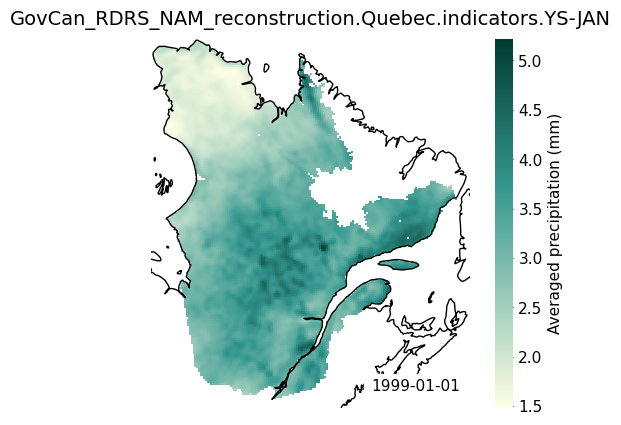

...

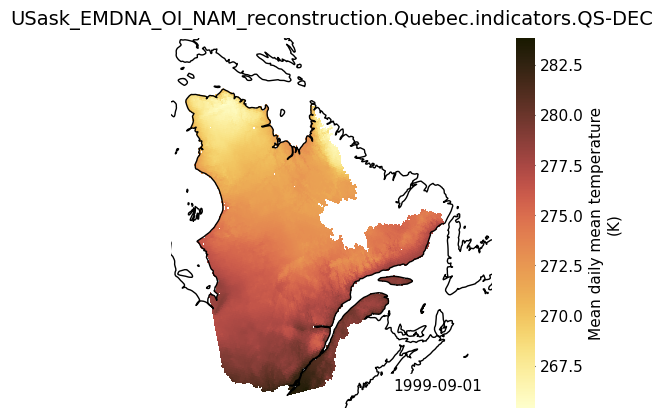

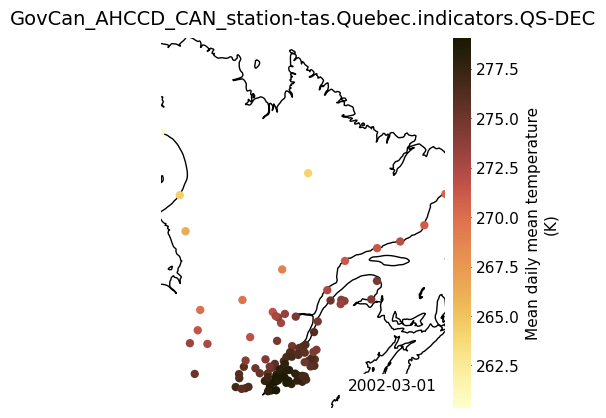

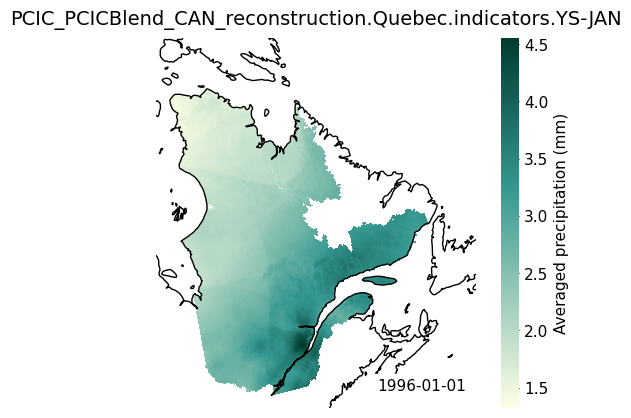

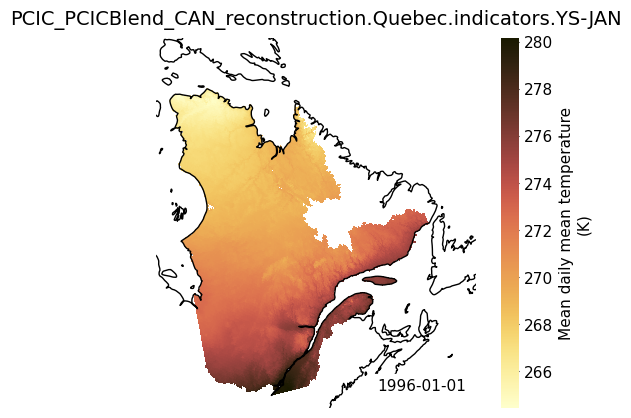

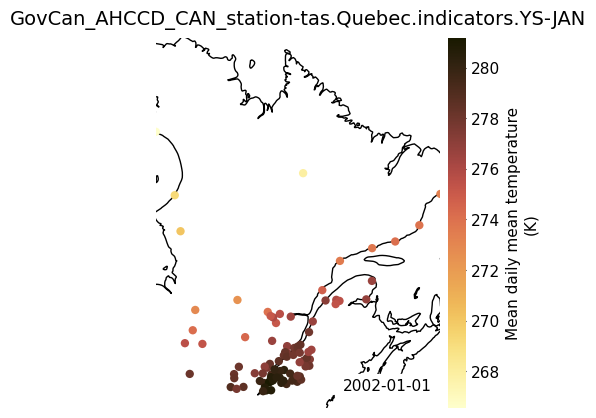

In [13]:
plot(processing_level='indicators')


--> The keys in the returned dictionary of datasets are constructed as follows:
	'id.domain.processing_level.xrfreq'


/exec/abuyalo/.conda/envs/obsflow/lib/python3.12/site-packages/xarray/plot/facetgrid.py:220: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
/exec/abuyalo/.conda/envs/obsflow/lib/python3.12/site-packages/figanos/matplotlib/plot.py:1748: UserWarning: 66 nan values were dropped when plotting the color values
/exec/abuyalo/.conda/envs/obsflow/lib/python3.12/site-packages/figanos/matplotlib/plot.py:1748: UserWarning: 95 nan values were dropped when plotting the color values
/exec/abuyalo/.conda/envs/obsflow/lib/python3.12/site-packages/figanos/matplotlib/plot.py:1748: UserWarning: 66 nan values were dropped when plotting the color values
/exec/abuyalo/.conda/envs/obsflow/lib/python3.12/site-packages/figanos/matplotlib/plot.py:174

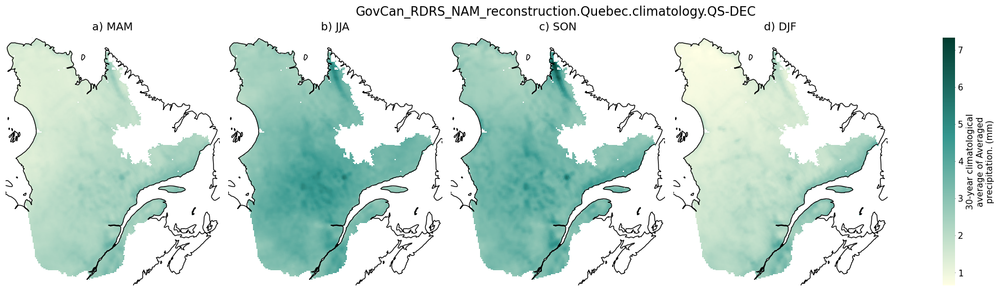

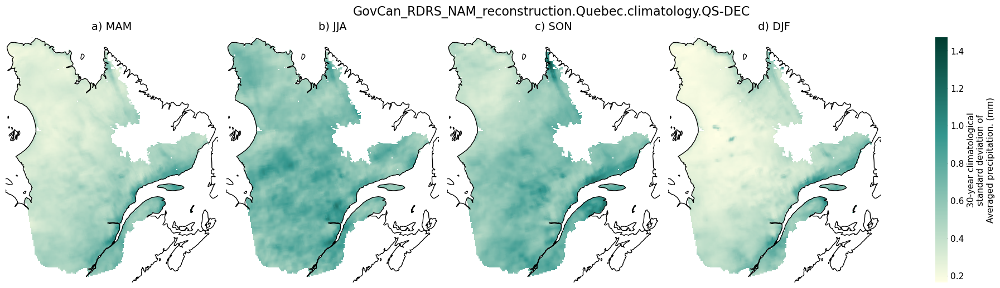

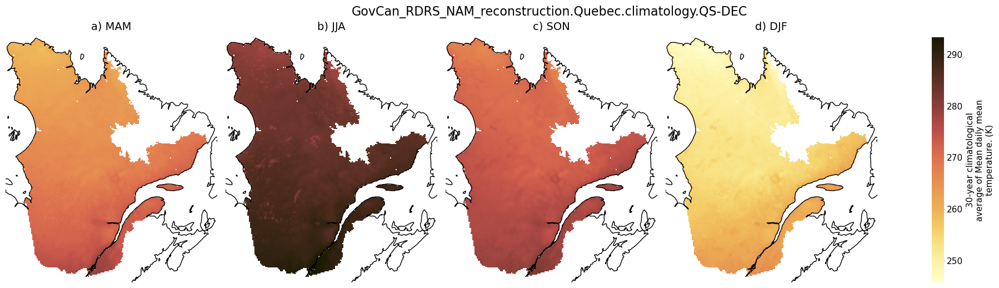

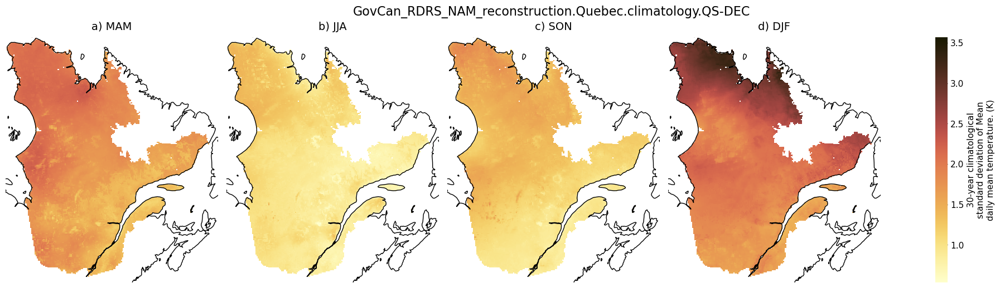

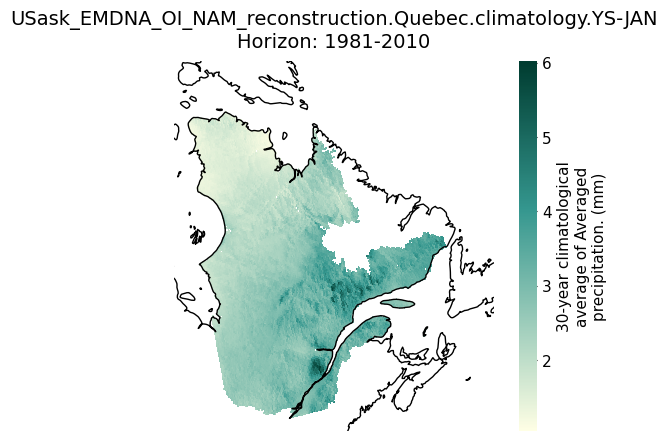

...

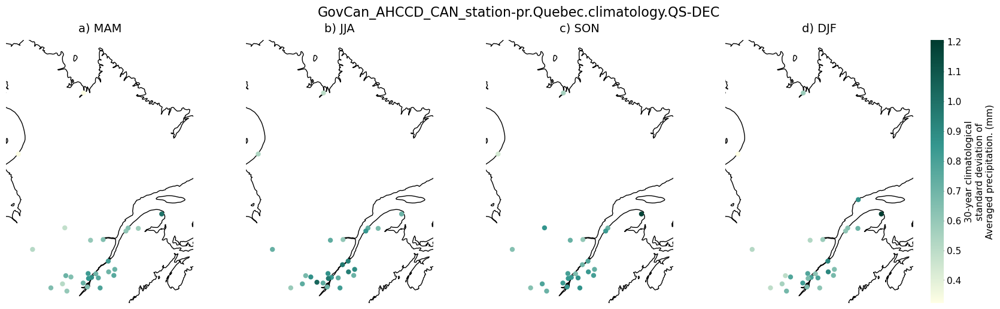

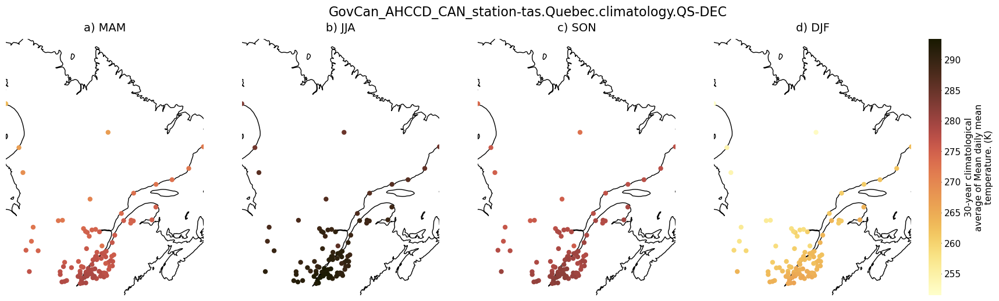

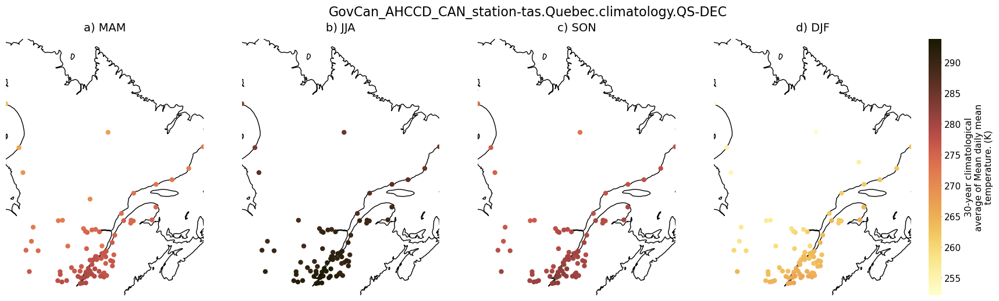

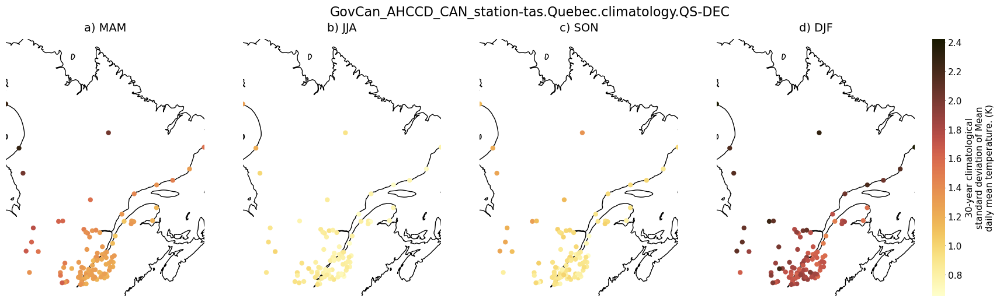

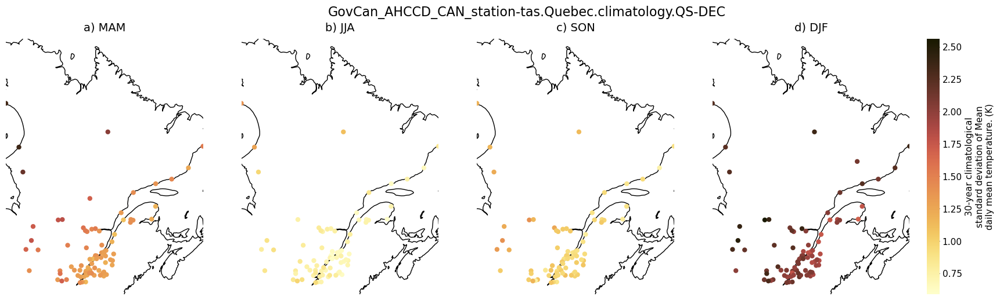

In [4]:
plot(processing_level='climatology')